In [1]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sb
import folium
from folium import Choropleth
import json

In [2]:
data_1213 = pd.read_csv('2012_2013.csv')
data_1314 = pd.read_csv('2013_2014.csv')
data_1415 = pd.read_csv('2014_2015.csv')
data_1516 = pd.read_csv('2015_2016.csv')
data_1617 = pd.read_csv('2016_2017.csv')
data_1718 = pd.read_csv('2017_2018.csv')
data_1819 = pd.read_csv('2018_2019.csv')
data_1920 = pd.read_csv('2019_2020.csv')
data_2021 = pd.read_csv('2020_2021.csv')
data_2122 = pd.read_csv('2021_2022.csv')
data_2223 = pd.read_csv('2022_2023.csv')

with open('nc_zipcodes.min.json', 'r') as zipcodeGeoJson:
    zipcodes = json.load(zipcodeGeoJson)['features']

**Zipcode Formatting**

nc_zipcodes.min.json is GeoJSON file with information about NC zipcodes that gets read into this notebook as a dictionary

The dictionary is of shape (808, 3) - 808 zipcodes with each entry containing keys 'type', 'properties', 'geometry'

We care specifically about ['properties']['ZCTA5CE10'] (the actual zipcode) and ['geometry']['coordinates'] (the coordinates of zipcode region corners on a map)
- ['properties']['ZCTA5CE10'] is a string
- ['geometry']['coordinates'] is a list of shape (1, n, 2) where n is the number of corners and each corner is represented by a (lat, lon) ordered pair

In [3]:
### Formatting zipcodes

zipcode_df = pd.DataFrame()

codes = []
coords = []
for zc in zipcodes:
    codes.append(zc['properties']['ZCTA5CE10'])
    coords.append(zc['geometry']['coordinates'][0])

zipcode_df['zipcode'] = codes
zipcode_df['coords'] = coords

By year, show transitions between years?

**City/School**
- Table
- Piechart or barchart

**Zip**
- Map?

In [4]:

NCZips = pd.read_csv('uszips.csv')

# Filter the DataFrame to include only rows where 'state_id' is 'NC'
NCZips = NCZips[NCZips['state_id'] == 'NC']

# Drop unnecessary columns
NCZips = NCZips[['zip', 'lat', 'lng', 'county_name', 'state_id']]
NCZips = NCZips[NCZips['zip'].isin(data_2223['Billing Zip/Postal Code'])]
NCZips

,zip,lat,lng,county_name,state_id
8488,27012,36.00434,-80.37547,Forsyth,NC
8545,27243,36.07821,-79.19450,Orange,NC
8560,27278,36.08673,-79.08778,Orange,NC
8569,27298,35.88563,-79.56816,Randolph,NC
8572,27302,36.13749,-79.26470,Alamance,NC
8577,27312,35.75446,-79.19648,Chatham,NC
8617,27455,36.18283,-79.80794,Guilford,NC
8618,27501,35.48684,-78.68419,Harnett,NC
8619,27502,35.72123,-78.90828,Wake,NC
8621,27504,35.39963,-78.51863,Johnston,NC


In [5]:
### 2022 - 2023 zipcodes

# Folium intro: https://medium.com/analytics-vidhya/data-visualizations-for-zip-codes-2bbf1e16cab0
zips = data_2223['Billing Zip/Postal Code'].value_counts()
map = folium.Map(location=[35.7915, -78.781120], default_zoom_start=10)
folium.Choropleth(
    geo_data = 'nc_zipcodes.min.json', 
    data = zips, 
    key_on='feature.properties.ZCTA5CE10',
    fill_color='BuPu',
    fill_opacity=1,
    line_opacity=0.2, 
    legend_name='SALE PRICE').add_to(map)
zips = data_2223['Billing Zip/Postal Code'].value_counts().reset_index()
zips.columns = ['zip', 'count']
NCMerge = NCZips.merge(zips, on='zip', how='inner')
for index, location_info in NCMerge.iterrows():
    folium.Marker([location_info["lat"], location_info["lng"]],
                  popup="County: " + location_info["county_name"] +"<br>"+ "Pop: " + str(location_info["count"], #display business name
                  #fill_color="#3db7e4" #color businesses
             )).add_to(map)
map

In [6]:

data_1213_unique = data_1213.drop_duplicates(subset=['Full Name', 'Billing Street'])
data_1314_unique = data_1314.drop_duplicates(subset=['Full Name', 'Billing Street'])
data_1415_unique = data_1415.drop_duplicates(subset=['Full Name', 'Billing Street'])
data_1516_unique = data_1516.drop_duplicates(subset=['Full Name', 'Billing Street'])
data_1617_unique = data_1617.drop_duplicates(subset=['Full Name', 'Billing Street'])
data_1718_unique = data_1718.drop_duplicates(subset=['Full Name', 'Billing Street'])
data_1819_unique = data_1819.drop_duplicates(subset=['Full Name', 'Billing Street'])
data_1920_unique = data_1920.drop_duplicates(subset=['Full Name', 'Billing Street'])
data_2021_unique = data_2021.drop_duplicates(subset=['Full Name', 'Billing Street'])
data_2122_unique = data_2122.drop_duplicates(subset=['Full Name', 'Billing Street'])

# Merge the dataframes into one
unique_df = [data_1213_unique]

# Calculate the total number of years each student has been involved
for df in unique_df:
    df['Years Involved'] = 1

# Merge the dataframes into one
merged_data = pd.concat(unique_df)

# Calculate the total number of years each student has been involved
years_involved = merged_data.groupby(['Full Name', 'Billing Street'])['Years Involved'].sum().reset_index()

# Sort the result by year (optional)
years_involved = years_involved.sort_values(by='Years Involved', ascending=False)

years_involved


/var/folders/v3/gscnz8m95s9g66l16j62sd7c0000gn/T/ipykernel_30580/825000076.py:17: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['Years Involved'] = 1


,Full Name,Billing Street,Years Involved
0,Abby Sun,704 Quartz Crystal Place,1
1,Abhraneel Dutta,303 Cricketfield Lane,1
284,Neha Vangipurapu,209 Oceanside Ln,1
283,Neel Kamo,2668 West Creek Drive,1
282,Nathan Tilley,2700 Little River Church Road,1
...,...,...,...
135,Grace Raphun,2109 Nancy Ann Drive,1
134,Grace Cline,6101 Bordesley Ct.,1
133,Grace Chow,403 Livingstone Drive,1
132,Gloria Chien,107 Summey Court,1


In [7]:
grouped_data = data_1213_unique.set_index(['Full Name', 'Billing Street'])

# Check if the index of years_involved is in grouped_data
years_involved.index.isin(grouped_data.index)

# Display the result
years_involved

,Full Name,Billing Street,Years Involved
0,Abby Sun,704 Quartz Crystal Place,1
1,Abhraneel Dutta,303 Cricketfield Lane,1
284,Neha Vangipurapu,209 Oceanside Ln,1
283,Neel Kamo,2668 West Creek Drive,1
282,Nathan Tilley,2700 Little River Church Road,1
...,...,...,...
135,Grace Raphun,2109 Nancy Ann Drive,1
134,Grace Cline,6101 Bordesley Ct.,1
133,Grace Chow,403 Livingstone Drive,1
132,Gloria Chien,107 Summey Court,1


In [8]:
# Merge the dataframes into one
unique_df = [data_1213_unique, data_1314_unique, data_1415_unique, data_1516_unique]

# Calculate the total number of years each student has been involved
for df in unique_df:
    df['Years Involved'] = 1

# Merge the dataframes into one
merged_data = pd.concat(unique_df)

# Calculate the total number of years each student has been involved
years_involved1516 = merged_data.groupby(['Full Name', 'Billing Street'])['Years Involved'].sum().reset_index()

# Sort the result by year (optional)
years_involved1516 = years_involved1516.sort_values(by='Full Name', ascending=False)
data_2122_unique = years_involved1516.drop_duplicates(subset=['Full Name', 'Billing Street'])

df1516 = years_involved1516.merge(data_1516_unique, on=['Full Name', 'Billing Street'])
df1516



/var/folders/v3/gscnz8m95s9g66l16j62sd7c0000gn/T/ipykernel_30580/2164345353.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['Years Involved'] = 1
/var/folders/v3/gscnz8m95s9g66l16j62sd7c0000gn/T/ipykernel_30580/2164345353.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['Years Involved'] = 1
/var/folders/v3/gscnz8m95s9g66l16j62sd7c0000gn/T/ipykernel_30580/2164345353.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_i

,Full Name,Billing Street,Years Involved_x,Unnamed: 1,Application Name,First Name,Last Name,Billing City,Billing State/Province,Billing Zip/Postal Code,...,Parent 2: Phone,Years Played,School Music Teacher: Full Name,School Music Teacher: Email,Participate in School Music Program?,Reason Not in School Ensemble,Private Music Teacher: Full Name,Grade Fall Current Calendar Year,Current School: Account Name,Years Involved_y
0,Zachary Jacobs,107 Briarwood Drive,4,NaN,"Jacobs, Zachary 2015-16",Zachary,Jacobs,Clayton,NC,27520,...,NaN,10.0,David Kilbride,dbkilbride@yahoo.com,True,NaN,Shelley Livingston,11,Raleigh Charter High,1
1,Yebin Park,105 Horsepond Ct.,4,NaN,"Park, Yebin 2015-16",Yebin,Park,Cary,NC,27513,...,NaN,12.0,David Wilson,dbwilson@wcpss.net,True,NaN,NaN,12,Green Hope High,1
2,Yamini Ramadurai,841 Katahdin Way,1,NaN,"Ramadurai, Yamini 2015-16",Yamini,Ramadurai,Cary,NC,27519,...,(919) 461-3797,1.0,Winifred Marecheau,NaN,True,NaN,NaN,6,Carnage Middle,1
3,Xenia Codreanu,2720 Stageline Drive,2,NaN,"Codreanu, Xenia 2015-16",Xenia,Codreanu,Raleigh,NC,27603,...,(828) 385-2311,8.0,Tara Anne Culbreth,tculbreth@wcpss.net,True,NaN,Hyuk-jong Yi,11,Cary High,1
4,Woody Livesay,3300 Marblehead Lane,2,NaN,"Livesay, Woody 2015-16",Woody,Livesay,Raleigh,NC,27612,...,(919) 247-0351,5.0,NaN,NaN,False,NaN,Lyda Cruden,6,Oberlin Magnet Middle,1
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
407,Achyuta Anandakrishnan,517 Waverly Hills Drive,1,NaN,"Anandakrishnan, Achyuta 2015-16",Achyuta,Anandakrishnan,Cary,NC,27519,...,(919) 760-9907,2.0,NaN,NaN,False,NaN,Rebecca Carlson,4,Fuller Elementary,1
408,Abigail Oentung,824 Blackmar St,3,NaN,"Oentung, Abigail 2015-16",Abigail,Oentung,Cary,NC,27519,...,NaN,3.0,NaN,NaN,False,NaN,David Oh,8,Cary Academy,1
409,Abigail Marshall,214 Fairdale Ct,4,NaN,"Marshall, Abigail 2015-16",Abigail,Marshall,Apex,NC,27502,...,NaN,9.0,NaN,NaN,True,NaN,NaN,9,Apex High,1
410,Aaron Williams,507 Trolley Car Way,2,NaN,"Williams, Aaron 2015-16",Aaron,Williams,Morrisville,NC,27560,...,(919) 316-0743,3.0,Cynthia Brown,cbrown@raleighcharterhs.org,True,NaN,Dennis De Jong,9,Raleigh Charter High,1


In [9]:
data_1516_unique

,Full Name,Unnamed: 1,Application Name,First Name,Last Name,Billing Street,Billing City,Billing State/Province,Billing Zip/Postal Code,Email,...,Parent 2: Phone,Years Played,School Music Teacher: Full Name,School Music Teacher: Email,Participate in School Music Program?,Reason Not in School Ensemble,Private Music Teacher: Full Name,Grade Fall Current Calendar Year,Current School: Account Name,Years Involved
0,Adam Rouzky,NaN,"Rouzky, Adam 2015-16",Adam,Rouzky,1904 Grace Point Rd,Morrisville,NC,27560,rouzky@gmail.com,...,NaN,3.0,NaN,NaN,False,NaN,Karen Strittmatter Galvin,7,Triangle Math and Science Academy,1
1,William Pashby,NaN,"Pashby, William 2015-16",William,Pashby,1212 Milhous Dr.,Cary,NC,27513,william.pashby@gmail.com,...,NaN,8.0,NaN,NaN,True,NaN,Bonnie Thron,12,Home School,1
2,Kimberly Berry,NaN,"Berry, Kimberly 2015-16",Kimberly,Berry,3141 Cooper Circle,Creedmoor,NC,27522,crunchberries@mac.com,...,(919) 257-7645,6.0,NaN,NaN,False,NaN,Georgia Schmidt,6,Home School,1
3,Hannah-marie Santos,NaN,"Santos, Hannah-Marie 2015-16",Hannah-marie,Santos,325 Mickelson Ridge Dr,Raleigh,NC,27603,jeanney21@gmail.com,...,(919) 559-1188,3.0,NaN,NaN,True,NaN,Lyda Cruden,7,Wake Young Women's Leadership Academy,1
4,Ronan Moore,NaN,"Moore, Ronan 2015-16",Ronan,Moore,307 Hudson St.,Raleigh,NC,27608,roskimo@gmail.com,...,NaN,4.0,Renee Todd,rttrumpet@gmail.com,True,NaN,Kevin Rader-Rhodenbaugh,7,Ligon Middle,1
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
419,Swaycha Goli,NaN,"Goli, Swaycha 2015-16",Swaycha,Goli,105 Baybrook Ct,Cary,NC,27518,sgviolin@hotmail.com,...,9196065825,10.0,Winifred Marecheau,NaN,True,NaN,Marta Partridge,8,Carnage Middle,1
420,Emily Qiu,NaN,"Qiu, Emily 2015-16",Emily,Qiu,305 Edgemore Ave,Cary,NC,27519,emilycqiu@gmail.com,...,(510) 326-9608,5.0,NaN,NaN,False,NaN,Julie Frederick,8,Mills Park Middle,1
421,Rohan Ray,NaN,"Ray, Rohan 2015-16",Rohan,Ray,112 Rattle Snap Ct,Cary,NC,27519,raypatriots71@gmail.com,...,(919) 457-3221,8.0,Winifred Marecheau,NaN,True,NaN,NaN,8,Carnage Middle,1
422,Lily Lauffer,NaN,"Lauffer, Lily 2015-16",Lily,Lauffer,112 Langshire Court,Apex,NC,27502,NaN,...,NaN,4.0,NaN,NaN,False,NaN,Lisa Malcolm,7,Home School,1


In [10]:
unique_df = [data_1213_unique, data_1314_unique, data_1415_unique, data_1516_unique,data_1617_unique, data_1718_unique,data_1819_unique]

# Calculate the total number of years each student has been involved
for df in unique_df:
    df['Years Involved'] = 1

# Merge the dataframes into one
merged_data = pd.concat(unique_df)

# Calculate the total number of years each student has been involved
years_involved1819 = merged_data.groupby(['Full Name', 'Billing Street'])['Years Involved'].sum().reset_index()

# Sort the result by year (optional)
years_involved1819 = years_involved1819.sort_values(by='Full Name', ascending=False)

df1819 = years_involved1819.merge(data_1819_unique, on=['Full Name', 'Billing Street'])
df1819

/var/folders/v3/gscnz8m95s9g66l16j62sd7c0000gn/T/ipykernel_30580/2633820998.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['Years Involved'] = 1
/var/folders/v3/gscnz8m95s9g66l16j62sd7c0000gn/T/ipykernel_30580/2633820998.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['Years Involved'] = 1
/var/folders/v3/gscnz8m95s9g66l16j62sd7c0000gn/T/ipykernel_30580/2633820998.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_i

,Full Name,Billing Street,Years Involved_x,Unnamed: 1,Application Name,First Name,Last Name,Billing City,Billing State/Province,Billing Zip/Postal Code,...,Parent 2: Phone,Years Played,School Music Teacher: Full Name,School Music Teacher: Email,Participate in School Music Program?,Reason Not in School Ensemble,Private Music Teacher: Full Name,Grade Fall Current Calendar Year,Current School: Account Name,Years Involved_y
0,Zebedee Jewell-Alibhai,"402 Harkness Circle, Harkness Circle",1,NaN,"Jewell-alibhai, Zebedee 2018-19",Zebedee,Jewell-Alibhai,Durham,NC,27705,...,(919) 886-9567,7,NaN,NaN,False,Other (please explain),Keenan McKenzie,8.0,Durham Academy Middle,1
1,Yusuf Halim-Jordan,2032 Rainy Lake St,1,NaN,"Halim-jordan, Yusuf 2018-19",Yusuf,Halim-Jordan,Wake Forest,NC,27587,...,(407) 308-9180,5,Matt DiDonna,mdidonna@wcpss.net,True,NaN,None,7.0,Rolesville Middle,1
2,Yixuan Zhao,163 Hilda Grace Ln,1,NaN,"Zhao, Yixuan 2018-19",Yixuan,Zhao,Cary,NC,27519,...,NaN,2,NaN,NaN,False,Other (please explain),Jenny Zhou,4.0,Davis Drive Elementary,1
3,Yeji Na,345 Roberts Ridge Dr,1,NaN,"Na, Yeji 2018-19",Yeji,Na,Cary,NC,27513,...,NaN,2,None,NaN,True,NaN,Jina Won,6.0,Cary Christian School,1
4,Xinhao Ling,523 Portstewart Dr,1,NaN,"Ling, Xinhao 2018-19",Xinhao,Ling,Cary,NC,27519,...,NaN,1,NaN,NaN,False,Does not offer ensemble program,Private Teacher Not Found,5.0,Chesterbrook Academy,1
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
398,Abigail Oentung,824 Blackmar St,6,NaN,"Oentung, Abigail 2018-19",Abigail,Oentung,Cary,NC,27519,...,NaN,5,NaN,NaN,False,Does not offer ensemble program,David Oh,11.0,Cary Christian School,1
399,Abigail Marshall,214 Fairdale Ct,6,NaN,"Marshall, Abigail 2018-19",Abigail,Marshall,Apex,NC,27502,...,NaN,3,Todd Miller,tkjrmiller@yahoo.com,True,NaN,Petra Berenyi,12.0,Apex High,1
400,Abby Li,1021 Holtridge Drive,3,NaN,"Li, Abby 2018-19",Abby,Li,Apex,NC,27523,...,(919) 525-8810,4,Eric Grush,eric_grush@caryacademy.org,True,NaN,Anne Dyke,9.0,Cary Academy,1
401,Abby Caldwell,3123 Canoe Brook Pkwy,1,NaN,"Caldwell, Abby 2018-19",Abby,Caldwell,Raleigh,NC,27614,...,(919) 889-5989,6,Leroy Barley,leroy.barley@nrcaknights.com,True,NaN,Jimmy Gilmore,11.0,North Raleigh Christian Academy,1


In [11]:
unique_df = [data_1213_unique, data_1314_unique, data_1415_unique, data_1516_unique,data_1617_unique, data_1718_unique,data_1819_unique, data_1920_unique]

# Calculate the total number of years each student has been involved
for df in unique_df:
    df['Years Involved'] = 1

# Merge the dataframes into one
merged_data = pd.concat(unique_df)

# Calculate the total number of years each student has been involved
years_involved1920 = merged_data.groupby(['Full Name', 'Billing Street'])['Years Involved'].sum().reset_index()

# Sort the result by year (optional)
years_involved1920 = years_involved1920.sort_values(by='Full Name', ascending=False)

df1920 = years_involved1920.merge(data_1920_unique, on=['Full Name', 'Billing Street'])
df1920

/var/folders/v3/gscnz8m95s9g66l16j62sd7c0000gn/T/ipykernel_30580/196279833.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['Years Involved'] = 1
/var/folders/v3/gscnz8m95s9g66l16j62sd7c0000gn/T/ipykernel_30580/196279833.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['Years Involved'] = 1


,Full Name,Billing Street,Years Involved_x,Unnamed: 1,Application Name,First Name,Last Name,Billing City,Billing State/Province,Billing Zip/Postal Code,...,Parent 2: Phone,Years Played,School Music Teacher: Full Name,School Music Teacher: Email,Participate in School Music Program?,Reason Not in School Ensemble,Private Music Teacher: Full Name,Grade Fall Current Calendar Year,Current School: Account Name,Years Involved_y
0,Zebedee Jewell-Alibhai,"402 Harkness Circle, Harkness Circle",2,NaN,"Jewell-Alibhai, Zebedee 2019-20",Zebedee,Jewell-Alibhai,Durham,NC,27705,...,(919) 886-9567,8,NaN,NaN,False,Appropriate level not offered for grade,Keenan McKenzie,9,Durham Academy,1
1,Yusuf Halim-Jordan,2032 Rainy Lake St,2,NaN,"Halim, Yusuf 2019-20",Yusuf,Halim-Jordan,Wake Forest,NC,27587,...,(407) 308-9180,6,Matt DiDonna,mdidonna@wcpss.net,True,NaN,None,8,Rolesville Middle,1
2,Yixuan Zhao,163 Hilda Grace Ln,2,NaN,"Zhao, Yixuan 2019-20",Yixuan,Zhao,Cary,NC,27519,...,NaN,3,NaN,NaN,False,Does not offer ensemble program,Jenny Zhou,5,Davis Drive Elementary,1
3,Woody Livesay,3300 Marblehead Lane,6,NaN,"Livesay, Woody 2019-20",Woody,Livesay,Raleigh,NC,27612,...,(919) 247-0351,9,Marjorie Harrison,mharrison3@wcpss.net,True,NaN,Lyda Cruden,10,Broughton High,1
4,Winston Alexander,414 Grand Highclere Way,1,NaN,"Alexander, Winston 2019-20",Winston,Alexander,Apex,NC,27523,...,(919) 740-5075,1,NaN,NaN,False,Does not offer ensemble program,Attia Szasz,7,Mills Park Middle,1
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
400,Adam Kashmola,431 Powers Ferry Road,3,NaN,"Kashmola, Adam 2019-20",Adam,Kashmola,Cary,NC,27519,...,NaN,4,NaN,NaN,False,Does not offer ensemble program,Jacobus Hermsen,10,Green Level High,1
401,Abhinav Indukuri,228 Elmhaven Way,1,NaN,"Indukuri, Abhinav 2019-20",Abhinav,Indukuri,Morrisville,NC,27560,...,(919) 389-4694,9,NaN,NaN,False,Schedule Conflict (please explain),Emily Savage,9,Raleigh Charter High,1
402,Abby Li,1021 Holtridge Drive,4,NaN,"Li, Abby 2019-20",Abby,Li,Apex,NC,27523,...,(919) 345-2096,4,Lester Turner,NaN,True,NaN,Anne Dyke,10,Cary Academy,1
403,Abby Caldwell,3123 Canoe Brook Pkwy,2,NaN,"Caldwell, Abby 2019-20",Abby,Caldwell,Raleigh,NC,27614,...,(919) 888-3541,7,Leroy Barley,leroy.barley@nrcaknights.com,True,NaN,Jimmy Gilmore,12,North Raleigh Christian Academy,1


In [12]:
unique_df = [data_1213_unique, data_1314_unique, data_1415_unique, data_1516_unique,data_1617_unique, data_1718_unique,data_1819_unique, data_1920_unique, data_2021_unique]

# Calculate the total number of years each student has been involved
for df in unique_df:
    df['Years Involved'] = 1

# Merge the dataframes into one
merged_data = pd.concat(unique_df)

# Calculate the total number of years each student has been involved
years_involved2021 = merged_data.groupby(['Full Name', 'Billing Street'])['Years Involved'].sum().reset_index()

# Sort the result by year (optional)
years_involved2021 = years_involved2021.sort_values(by='Full Name', ascending=False)

df2021 = years_involved2021.merge(data_2021_unique, on=['Full Name', 'Billing Street'])
df2021

/var/folders/v3/gscnz8m95s9g66l16j62sd7c0000gn/T/ipykernel_30580/182487112.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['Years Involved'] = 1
/var/folders/v3/gscnz8m95s9g66l16j62sd7c0000gn/T/ipykernel_30580/182487112.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['Years Involved'] = 1


,Full Name,Billing Street,Years Involved_x,Unnamed: 1,Application Name,First Name,Last Name,Billing City,Billing State/Province,Billing Zip/Postal Code,...,Parent 2: Phone,Years Played,School Music Teacher: Full Name,School Music Teacher: Email,Participate in School Music Program?,Reason Not in School Ensemble,Private Music Teacher: Full Name,Grade Fall Current Calendar Year,Current School: Account Name,Years Involved_y
0,Zebedee Jewell-Alibhai,"402 Harkness Circle, Harkness Circle",3,NaN,"Jewell-alibhai, Zebedee 2020-21",Zebedee,Jewell-Alibhai,Durham,NC,27705,...,(919) 886-9567,9,Michael Meyer,michael.meyer@da.org,True,NaN,Keenan McKenzie,10,Durham Academy,1
1,Yudi Jin,312 Derby Mill Ct,1,NaN,"Jin, Yudi 2020-21",Yudi,Jin,Cary,NC,27519,...,(919) 599-7593,3,NaN,NaN,False,Does not offer ensemble program,Yiying Qiao,4,Green Hope Elementary,1
2,Youyou Li,324 Terrastone Place,1,NaN,"Li, Youyou 2020-21",Youyou,Li,Cary,NC,27519,...,(919) 995-1636,1,NaN,NaN,False,Does not offer ensemble program,Luciola Lewis,7,Davis Drive Middle,1
3,Yixuan Zhao,163 Hilda Grace Ln,3,NaN,"Zhao, Yixuan 2020-21",Yixuan,Zhao,Cary,NC,27519,...,(919) 917-3954,3,NaN,NaN,False,Appropriate level not offered for grade,Jenny Zhou,6,Cary Academy,1
4,Yitong Sun,327 Sunstone Dr,1,NaN,"Sun, Yitong 2020-21",Yitong,Sun,Cary,NC,27519,...,NaN,9,Alice Ju,alice.ju@gmail.com,True,NaN,Hsaio-Me Ku,9,Green Hope High,1
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
336,Adam Kashmola,431 Powers Ferry Road,4,NaN,"Kashmola, Adam 2020-21",Adam,Kashmola,Cary,NC,27519,...,NaN,5,NaN,NaN,False,Does not offer ensemble program,Jacobus Hermsen,11,Green Level High,1
337,Abigail Kollu,1204 Celestine Pl,1,NaN,"Kollu, Abigail 2020-21",Abigail,Kollu,Apex,NC,27502,...,(919) 402-7306,2,Beth McCollum,emccollum@wcpss.net,True,NaN,Meaghan Clayton,12,Enloe High,1
338,Abhinav Meduri,207 Fairchild Downs Place,1,NaN,"Meduri, Abhinav 2020-21",Abhinav,Meduri,Cary,NC,27518,...,(919) 602-7272,4,NaN,NaN,False,Schedule Conflict (please explain),Lindi Wang,9,Enloe High,1
339,Abby Li,1021 Holtridge Drive,5,NaN,"Li, Abby 2020-21",Abby,Li,Apex,NC,27523,...,(919) 525-8810,5,Lester Turner,NaN,True,NaN,Anne Dyke,11,Cary Academy,1


In [13]:
unique_df = [data_1213_unique, data_1314_unique, data_1415_unique, data_1516_unique, data_1617_unique, data_1718_unique,data_1819_unique, data_1920_unique, data_2021_unique,data_2122_unique]

# Calculate the total number of years each student has been involved
for df in unique_df:
    df['Years Involved'] = 1

# Merge the dataframes into one
merged_data = pd.concat(unique_df)

# Calculate the total number of years each student has been involved
years_involved2122 = merged_data.groupby(['Full Name', 'Billing Street'])['Years Involved'].sum().reset_index()

# Sort the result by year (optional)
years_involved2122 = years_involved2122.sort_values(by='Full Name', ascending=False)

df2122 = years_involved2122.merge(data_2122_unique, on=['Full Name', 'Billing Street'])
pd.set_option('display.max_colwidth', None)
df2122

/var/folders/v3/gscnz8m95s9g66l16j62sd7c0000gn/T/ipykernel_30580/2880418647.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['Years Involved'] = 1


,Full Name,Billing Street,Years Involved_x,Years Involved_y
0,ZehrJahi Brown,580 Ranch Road,2,1
1,Zayd Bryant,401 Foxwood Dr,2,1
2,Zachary Tripp,7261 Shawan Road,3,1
3,Zachary Schwartz,6340 Deerview Drive,4,1
4,Zachary Park,12721 Softbreeze Lane,2,1
...,...,...,...,...
873,Abigail Marshall,214 Fairdale Ct,7,1
874,Abhraneel Dutta,303 Cricketfield Lane,4,1
875,Abby Sun,704 Quartz Crystal Place,2,1
876,Aaron Williams,507 Trolley Car Way,3,1


In [14]:
print(df2122)

            Full Name            Billing Street  Years Involved_x  \
0      ZehrJahi Brown            580 Ranch Road                 2   
1         Zayd Bryant            401 Foxwood Dr                 2   
2       Zachary Tripp          7261 Shawan Road                 3   
3    Zachary Schwartz      6340  Deerview Drive                 4   
4        Zachary Park     12721 Softbreeze Lane                 2   
..                ...                       ...               ...   
873  Abigail Marshall           214 Fairdale Ct                 7   
874   Abhraneel Dutta     303 Cricketfield Lane                 4   
875          Abby Sun  704 Quartz Crystal Place                 2   
876    Aaron Williams       507 Trolley Car Way                 3   
877         Aaric Han         5216 Shergold St.                 5   

     Years Involved_y  
0                   1  
1                   1  
2                   1  
3                   1  
4                   1  
..                ...  
873

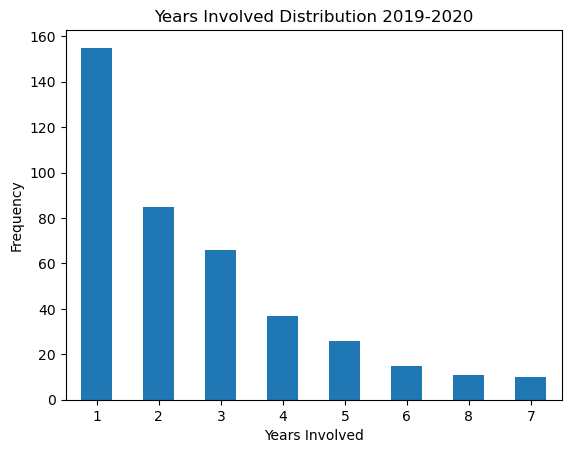

In [133]:
fig, ax = plt.subplots()
df = pd.DataFrame({'numbers': [2, 4, 1, 4, 3, 2, 1, 3, 2, 4]})
df1920['Years Involved_x'].value_counts().plot(ax=ax, kind='bar', xlabel='Years Involved', ylabel='Frequency', rot=0)
plt.title('Years Involved Distribution 2019-2020')
plt.show()

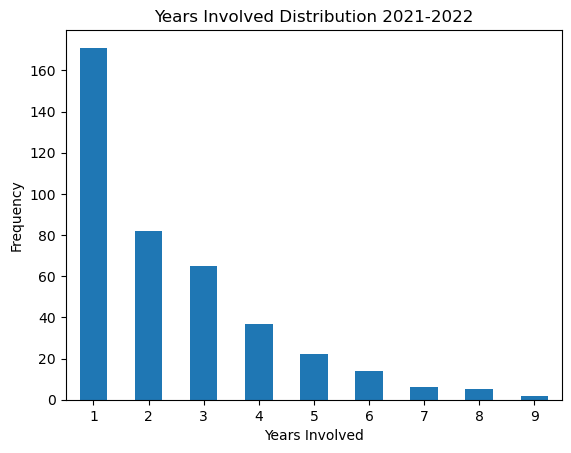

In [130]:
fig, ax = plt.subplots()
df = pd.DataFrame({'numbers': [2, 4, 1, 4, 3, 2, 1, 3, 2, 4]})
df2122['Years Involved_x'].value_counts().plot(ax=ax, kind='bar', xlabel='Years Involved', ylabel='Frequency', rot=0)
plt.title('Years Involved Distribution 2021-2022')
plt.show()

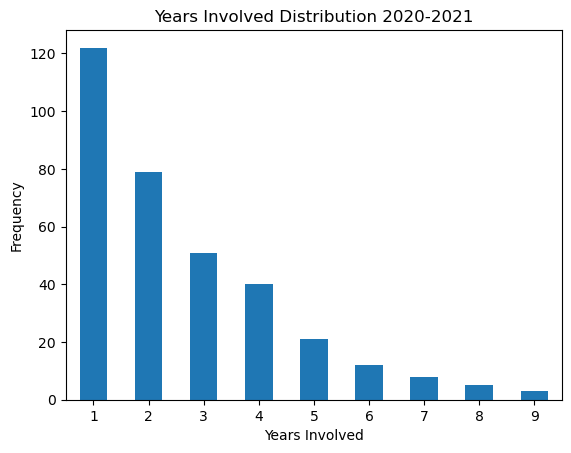

In [131]:
fig, ax = plt.subplots()
df = pd.DataFrame({'numbers': [2, 4, 1, 4, 3, 2, 1, 3, 2, 4]})
df2021['Years Involved_x'].value_counts().plot(ax=ax, kind='bar', xlabel='Years Involved', ylabel='Frequency', rot=0)
plt.title('Years Involved Distribution 2020-2021')
plt.show()

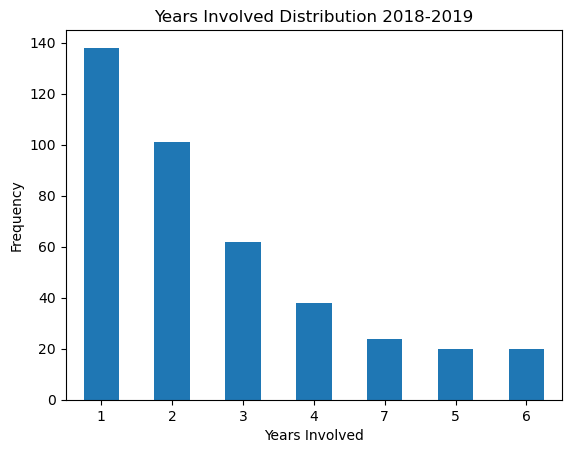

In [136]:
fig, ax = plt.subplots()
df = pd.DataFrame({'numbers': [2, 4, 1, 4, 3, 2, 1, 3, 2, 4]})
df1819['Years Involved_x'].value_counts().plot(ax=ax, kind='bar', xlabel='Years Involved', ylabel='Frequency', rot=0)
plt.title('Years Involved Distribution 2018-2019')
plt.show()

In [140]:
df2021

,Full Name,Billing Street,Years Involved_x,Unnamed: 1,Application Name,First Name,Last Name,Billing City,Billing State/Province,Billing Zip/Postal Code,...,Parent 2: Phone,Years Played,School Music Teacher: Full Name,School Music Teacher: Email,Participate in School Music Program?,Reason Not in School Ensemble,Private Music Teacher: Full Name,Grade Fall Current Calendar Year,Current School: Account Name,Years Involved_y
0,Zebedee Jewell-Alibhai,"402 Harkness Circle, Harkness Circle",3,NaN,"Jewell-alibhai, Zebedee 2020-21",Zebedee,Jewell-Alibhai,Durham,NC,27705,...,(919) 886-9567,9,Michael Meyer,michael.meyer@da.org,True,NaN,Keenan McKenzie,10,Durham Academy,1
1,Yudi Jin,312 Derby Mill Ct,1,NaN,"Jin, Yudi 2020-21",Yudi,Jin,Cary,NC,27519,...,(919) 599-7593,3,NaN,NaN,False,Does not offer ensemble program,Yiying Qiao,4,Green Hope Elementary,1
2,Youyou Li,324 Terrastone Place,1,NaN,"Li, Youyou 2020-21",Youyou,Li,Cary,NC,27519,...,(919) 995-1636,1,NaN,NaN,False,Does not offer ensemble program,Luciola Lewis,7,Davis Drive Middle,1
3,Yixuan Zhao,163 Hilda Grace Ln,3,NaN,"Zhao, Yixuan 2020-21",Yixuan,Zhao,Cary,NC,27519,...,(919) 917-3954,3,NaN,NaN,False,Appropriate level not offered for grade,Jenny Zhou,6,Cary Academy,1
4,Yitong Sun,327 Sunstone Dr,1,NaN,"Sun, Yitong 2020-21",Yitong,Sun,Cary,NC,27519,...,NaN,9,Alice Ju,alice.ju@gmail.com,True,NaN,Hsaio-Me Ku,9,Green Hope High,1
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
336,Adam Kashmola,431 Powers Ferry Road,4,NaN,"Kashmola, Adam 2020-21",Adam,Kashmola,Cary,NC,27519,...,NaN,5,NaN,NaN,False,Does not offer ensemble program,Jacobus Hermsen,11,Green Level High,1
337,Abigail Kollu,1204 Celestine Pl,1,NaN,"Kollu, Abigail 2020-21",Abigail,Kollu,Apex,NC,27502,...,(919) 402-7306,2,Beth McCollum,emccollum@wcpss.net,True,NaN,Meaghan Clayton,12,Enloe High,1
338,Abhinav Meduri,207 Fairchild Downs Place,1,NaN,"Meduri, Abhinav 2020-21",Abhinav,Meduri,Cary,NC,27518,...,(919) 602-7272,4,NaN,NaN,False,Schedule Conflict (please explain),Lindi Wang,9,Enloe High,1
339,Abby Li,1021 Holtridge Drive,5,NaN,"Li, Abby 2020-21",Abby,Li,Apex,NC,27523,...,(919) 525-8810,5,Lester Turner,NaN,True,NaN,Anne Dyke,11,Cary Academy,1


In [139]:
df1819

,Full Name,Billing Street,Years Involved_x,Unnamed: 1,Application Name,First Name,Last Name,Billing City,Billing State/Province,Billing Zip/Postal Code,...,Parent 2: Phone,Years Played,School Music Teacher: Full Name,School Music Teacher: Email,Participate in School Music Program?,Reason Not in School Ensemble,Private Music Teacher: Full Name,Grade Fall Current Calendar Year,Current School: Account Name,Years Involved_y
0,Zebedee Jewell-Alibhai,"402 Harkness Circle, Harkness Circle",1,NaN,"Jewell-alibhai, Zebedee 2018-19",Zebedee,Jewell-Alibhai,Durham,NC,27705,...,(919) 886-9567,7,NaN,NaN,False,Other (please explain),Keenan McKenzie,8.0,Durham Academy Middle,1
1,Yusuf Halim-Jordan,2032 Rainy Lake St,1,NaN,"Halim-jordan, Yusuf 2018-19",Yusuf,Halim-Jordan,Wake Forest,NC,27587,...,(407) 308-9180,5,Matt DiDonna,mdidonna@wcpss.net,True,NaN,None,7.0,Rolesville Middle,1
2,Yixuan Zhao,163 Hilda Grace Ln,1,NaN,"Zhao, Yixuan 2018-19",Yixuan,Zhao,Cary,NC,27519,...,NaN,2,NaN,NaN,False,Other (please explain),Jenny Zhou,4.0,Davis Drive Elementary,1
3,Yeji Na,345 Roberts Ridge Dr,1,NaN,"Na, Yeji 2018-19",Yeji,Na,Cary,NC,27513,...,NaN,2,None,NaN,True,NaN,Jina Won,6.0,Cary Christian School,1
4,Xinhao Ling,523 Portstewart Dr,1,NaN,"Ling, Xinhao 2018-19",Xinhao,Ling,Cary,NC,27519,...,NaN,1,NaN,NaN,False,Does not offer ensemble program,Private Teacher Not Found,5.0,Chesterbrook Academy,1
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
398,Abigail Oentung,824 Blackmar St,6,NaN,"Oentung, Abigail 2018-19",Abigail,Oentung,Cary,NC,27519,...,NaN,5,NaN,NaN,False,Does not offer ensemble program,David Oh,11.0,Cary Christian School,1
399,Abigail Marshall,214 Fairdale Ct,6,NaN,"Marshall, Abigail 2018-19",Abigail,Marshall,Apex,NC,27502,...,NaN,3,Todd Miller,tkjrmiller@yahoo.com,True,NaN,Petra Berenyi,12.0,Apex High,1
400,Abby Li,1021 Holtridge Drive,3,NaN,"Li, Abby 2018-19",Abby,Li,Apex,NC,27523,...,(919) 525-8810,4,Eric Grush,eric_grush@caryacademy.org,True,NaN,Anne Dyke,9.0,Cary Academy,1
401,Abby Caldwell,3123 Canoe Brook Pkwy,1,NaN,"Caldwell, Abby 2018-19",Abby,Caldwell,Raleigh,NC,27614,...,(919) 889-5989,6,Leroy Barley,leroy.barley@nrcaknights.com,True,NaN,Jimmy Gilmore,11.0,North Raleigh Christian Academy,1


In [22]:
len(data_2223.iloc[:, -1].unique())

85